In [1]:
# ====================================================
# |         Example code without class               |
# ====================================================
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm

from matplotlib import animation, rc

# Create a figure of size 8x6 inches, 80 dots per inch
fig = plt.figure(figsize=(12, 6), dpi=80)
plt.close()

axContour = fig.add_subplot(1, 2, 1)
axGraph = fig.add_subplot(1, 2, 2)

# Format coordinate spines of axGraph
axGraph.spines['right'].set_color('none')
axGraph.spines['top'].set_color('none')
axGraph.xaxis.set_ticks_position('bottom')
axGraph.spines['bottom'].set_position(('data', 0))
axGraph.yaxis.set_ticks_position('left')
axGraph.spines['left'].set_position(('data', 0))

# Config limit and ticks on each axis of axGraph
axGraph.set_xlim(-2, 2)
axGraph.set_ylim(-2, 2)
axGraph.set_xticks(np.linspace(-2,2,5,endpoint=True))
axGraph.set_yticks(np.linspace(-2,2,5,endpoint=True))

# Format coordinate spines of axGraph
axContour.spines['right'].set_color('none')
axContour.spines['top'].set_color('none')
axContour.xaxis.set_ticks_position('bottom')
axContour.spines['bottom'].set_position(('data', 0))
axContour.yaxis.set_ticks_position('left')
axContour.spines['left'].set_position(('data', 0))

# Config limit and ticks on each axis of axContour
axContour.set_xlim(-2, 2)
axContour.set_ylim(-2, 2)
axContour.set_xticks(np.linspace(-2,2,5,endpoint=True))
axContour.set_yticks(np.linspace(-2,2,5,endpoint=True))


def animate(i):
  # Each function is determined by a pair of a,b.
  # Generate a pair of a,b with given i
  a = 2-i/4
  b = -a+1

  # draw a single dot in axContour corresponding to 
  # generated pair of a,b
  axContour.plot([a], [b], 'go')

  # draw a corresponding graph of the 
  # function (determined by above pair a,b) in axGraph.
  # First, generage sample value of x
  # Second, calculate values of y corresponding values of x
  X = np.linspace(-2, 2, 256, endpoint=True)
  Y = a*X+b

  # Draw
  axGraph.plot(X, Y, color='green', linewidth=1.0, linestyle='-')
  return ()


def animationInit():
  # Generate sample of x, y in each corresponding range
  sampleX = np.linspace(-2, 2, 256, endpoint=True)
  sampleY = np.linspace(-2, 2, 256, endpoint=True)
  
  # using function np.meshgrid to generate samples of a, b
  A, B = np.meshgrid(sampleX, sampleY)

  # We wanna draw contour corresponding to x=1
  # on axContour. Well, let's assign
  # x=1 and calculate contour level - called z
  x = 1
  Z = A*x + B

  
  # using method contour of axContour to draw our contours
  CS = axContour.contour(A, B, Z, cmap=cm.rainbow)
  axContour.clabel(CS, inline=1, fontsize=10)
  return ()


# Let's generate an animation
anim = animation.FuncAnimation(
    fig=fig, 
    func=animate, 
    init_func=animationInit, 
    frames=18, 
    interval=100, 
    blit=True
)
rc('animation', html='jshtml')
anim

# replace anim by below code to save animation to file .mp4
# anim.save('animation.mp4')

In [0]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm

from matplotlib import animation, rc

# ==============================================================================
# Defines convenient functioins
# ==============================================================================

def formatCoordinateSpines(ax):
  ax.spines['right'].set_color('none')
  ax.spines['top'].set_color('none')
  ax.xaxis.set_ticks_position('bottom')
  ax.spines['bottom'].set_position(('data', 0))
  ax.yaxis.set_ticks_position('left')
  ax.spines['left'].set_position(('data', 0))


def formatCoordinateLimit(ax, x_range, y_range):
  ax.set_xlim(x_range[0], x_range[1])
  ax.set_ylim(x_range[0], x_range[1])
  ax.set_xticks(np.linspace(
      x_range[0],
      x_range[1],
      -x_range[0]+x_range[1]+1,
      endpoint=True
  ))
  ax.set_yticks(np.linspace(
      y_range[0],
      y_range[1],
      -y_range[0]+y_range[1]+1,
      endpoint=True
  ))


def drawGraphOfASingleFunction(ax, x_range, funcObj, color="red", linewidth=1.0, linestyle="-"):
  X = np.linspace(x_range[0], x_range[1], 256, endpoint=True)
  Y = funcObj.calculateY(X)
  ax.plot(X, Y, color, linewidth, linestyle)


def drawContourInFunctionSpace(ax, x_range, y_range, funcObj):
  sampleX = np.linspace(x_range[0], x_range[1], 256, endpoint=True)
  sampleY = np.linspace(y_range[0], y_range[1], 256, endpoint=True)
  A, B = np.meshgrid(sampleX, sampleY)
  Z = funcObj.calculateContourLevel(A, B)
  CS = axContour.contour(A, B, Z, cmap=cm.rainbow)
  ax.clabel(CS, inline=1, fontsize=10)


def drawDot(ax, horizontal, vertical, style):
  ax.plot([horizontal], [vertical], style)

# ==============================================================================
# End of utilities functions
# ==============================================================================


class LinearFunc:
  # this allow you to define a function object with 2 required methods:
  # - calculateY
  # - calculateContourLevel
  # These 2 methods will be invoked by functions: drawGraphOfASingleFunction, drawContourInFunctionSpace
  def __init__(self, A=None, X=None, B=None):
    self.X = X
    self.A = A
    self.B = B

  # yes, you define your own linear function f(x) right here
  def __equation(self, A, X, B):
    return A*X+B
  
  # Value of A, B are fixxed while calculating values of Y by X
  # Value of X is sampled by function np.linspace before
  def calculateY(self, X):
    return self.__equation(self.A, X, self.B)

  # Value of X is fixxed while calculating countour level.
  # Value of A, B are sampled by function np.linspace before
  def calculateContourLevel(self, A, B):
    return self.__equation(A, self.X, B)


x_range = [-2, 2]
y_range = [-2, 2]
a_range = [-2, 2]
b_range = [-2, 2]

# Create a figure of size 8x6 inches, 80 dots per inch
fig = plt.figure(figsize=(12, 6), dpi=80)
plt.close()

axContour = fig.add_subplot(1, 2, 1)
axGraph = fig.add_subplot(1, 2, 2)

formatCoordinateSpines(axGraph)
formatCoordinateSpines(axContour)
formatCoordinateLimit(axGraph, x_range, y_range)
formatCoordinateLimit(axContour, a_range, b_range)


def animationInit():
  drawContourInFunctionSpace(axContour, x_range, y_range, LinearFunc(X=1))
  return ()


def animate(i):
  A = 2-i/4
  B = -A+1
  drawDot(axContour, A, B, "go")
  drawGraphOfASingleFunction(axGraph, x_range, LinearFunc(A=A, B=B), color="green")
  return ()


anim = animation.FuncAnimation(
    fig=fig, func=animate, init_func=animationInit, 
    frames=100, interval=100, blit=True)
rc('animation', html='jshtml')
anim

# replace anim by below code to save animation to file .mp4
# anim.save('animation.mp4')

In [0]:
x_range = [-2, 2]
y_range = [-2, 2]
a_range = [-2, 2]
b_range = [-2, 2]
    
# Create a figure of size 8x6 inches, 80 dots per inch
fig = plt.figure(figsize=(12, 6), dpi=80)
plt.close()

axContour = fig.add_subplot(1, 2, 1)
axGraph = fig.add_subplot(1, 2, 2)

formatCoordinateSpines(axGraph)
formatCoordinateSpines(axContour)
formatCoordinateLimit(axContour, a_range, b_range)
formatCoordinateLimit(axGraph, x_range, y_range)


def animationInit():
  drawContourInFunctionSpace(axContour, x_range, y_range, LinearFunc(X=1))  
  return ()

def animate(i):
  B = -2 + i/4
  A = B**2/2-1

  drawDot(axContour, A, B, "bo")
  drawGraphOfASingleFunction(axGraph, x_range,  LinearFunc(A=A,B=B), color="blue")
  return ()
  
anim = animation.FuncAnimation(fig=fig, func=animate, init_func=animationInit, frames=18, interval=100, blit=True)
rc('animation', html='jshtml')
anim

# replace anim by below code to save animation to file .mp4
# anim.save('animation.mp4')

In [0]:
class SigmoidFunc:
  def __init__(self,A=None,X=None,B=None):
    self.X = X
    self.A = A
    self.B = B
  
  def __equation(self, A,X,B):
    return np.tanh(A*X+B)
    
  def calculateY(self, X):
    return self.__equation(self.A, X, self.B)
  
  def calculateContourLevel(self, A,B):
    return self.__equation(A,self.X,B)

x_range = [-2, 2]
y_range = [-2, 2]
a_range = [-2, 2]
b_range = [-2, 2]
    
# Create a figure of size 8x6 inches, 80 dots per inch
fig = plt.figure(figsize=(12, 6), dpi=80)
plt.close()

axContour = fig.add_subplot(1, 2, 1)
axGraph = fig.add_subplot(1, 2, 2)

formatCoordinateSpines(axGraph)
formatCoordinateSpines(axContour)
formatCoordinateLimit(axGraph, x_range, y_range)
formatCoordinateLimit(axContour, a_range, b_range)


def animationInit():
  drawContourInFunctionSpace(axContour, x_range, y_range, SigmoidFunc(X=1))  
  return ()

def animate(i):
  A = 2-i/4
  B = -A-0.25
  drawDot(axContour, A, B, "go")
  drawGraphOfASingleFunction(axGraph, x_range, SigmoidFunc(A=A,B=B), color="green")
  return ()
  
anim = animation.FuncAnimation(fig=fig, func=animate, init_func=animationInit, frames=18, interval=100, blit=True)
rc('animation', html='jshtml')
anim

# replace anim by below code to save animation to file .mp4
# anim.save('animation.mp4')

In [0]:
x_range = [-2, 2]
y_range = [-2, 2]
a_range = [-2, 2]
b_range = [-2, 2]
    
# Create a figure of size 8x6 inches, 80 dots per inch
fig = plt.figure(figsize=(12, 6), dpi=80)
plt.close()

axContour = fig.add_subplot(1, 2, 1)
axGraph = fig.add_subplot(1, 2, 2)

formatCoordinateSpines(axGraph)
formatCoordinateSpines(axContour)
formatCoordinateLimit(axGraph, x_range, y_range)
formatCoordinateLimit(axContour, x_range, y_range)


def animationInit():
  drawContourInFunctionSpace(axContour, x_range, y_range, SigmoidFunc(X=1))  
  return ()

def animate(i):
  B = -2 + i/4
  A = B**2/2-1
  drawDot(axContour, A, B, "bo")
  drawGraphOfASingleFunction(axGraph, x_range, SigmoidFunc(A=A,B=B), color="blue")
  return ()
  
anim = animation.FuncAnimation(fig=fig, func=animate, init_func=animationInit, frames=18, interval=100, blit=True)
rc('animation', html='jshtml')
anim

# replace anim by below code to save animation to file .mp4
# anim.save('animation.mp4')

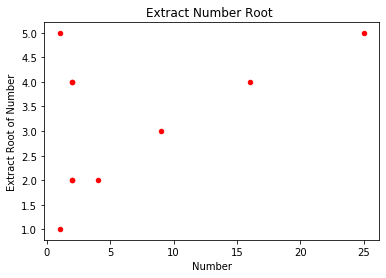

In [0]:
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

# Draw multiple points.
def draw_multiple_points():

    # x axis value list.
    x_number_list = [1, 4, 9, 16, 25,1,2,2,2,2]

    # y axis value list.
    y_number_list = [1, 2, 3, 4, 5,5,4,2,2,4]

    # Draw point based on above x, y axis values.
    plt.scatter(x_number_list, y_number_list, s=20, c='red')

    # Set chart title.
    plt.title("Extract Number Root ")

    # Set x, y label text.
    plt.xlabel("Number")
    plt.ylabel("Extract Root of Number")
    plt.show()


draw_multiple_points()

In [0]:
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

# Plot a line based on the x and y axis value list.
def draw_line():

    # List to hold x values.
    x_number_values = [1, 2, 3, 4, 5]

    # List to hold y values.
    y_number_values = [1, 4, 9, 16, 25]

    # Plot the number in the list and set the line thickness.
    plt.plot(x_number_values, y_number_values, linewidth=3, color='red')

    # Set the line chart title and the text font size.
    plt.title("Square Numbers", fontsize=19)

    # Set x axes label.
    plt.xlabel("Number Value", fontsize=10)

    # Set y axes label.
    plt.ylabel("Square of Number", fontsize=10)

    # Set the x, y axis tick marks text size.
    plt.tick_params(axis='both', labelsize=9)

    # Display the plot in the matplotlib's viewer.
    plt.show()

draw_line()

In [0]:
import numpy as np

class Perceptron(object):

    def __init__(self, no_of_inputs, threshold=100, learning_rate=0.01):
        self.threshold = threshold
        self.learning_rate = learning_rate
        self.weights = np.zeros(no_of_inputs + 1)
           
    def __predict_single_data(self, data):
        summation = np.dot(data, self.weights[1:]) + self.weights[0]
        if summation > 0:
          activation = 1
        else:
          activation = 0            
        return activation

    def predict(self, inputs):
      result = []
      for data in inputs:
        result.append(self.__predict_single_data(data))
      return result

    def train(self, training_inputs, labels):
        for _ in range(self.threshold):
            for inputs, label in zip(training_inputs, labels):
                pred = self.__predict_single_data(inputs)
                self.weights[1:] += self.learning_rate * (label - pred) * inputs
                self.weights[0] += self.learning_rate * (label - pred)



Accuracy: 89.00 %


In [0]:
# Generate data set
import numpy as np
from sklearn.model_selection import train_test_split

N = None
means = [[2, 2], [4, 4]]
cov = [[1, 0], [0, 1]]

N = 500
C = 2

X_0 = np.random.multivariate_normal(means[0], cov, N)
X_1 = np.random.multivariate_normal(means[1], cov, N)

X = np.concatenate((X_0, X_1), axis = 0)
y = np.array([[0]*N,[1]*N]).reshape(C*N,)



In [0]:


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20)

perceptron = Perceptron(no_of_inputs=2)
perceptron.train(X_train, y_train)

y_pred = perceptron.predict(X_test)

from sklearn.metrics import accuracy_score
print("Accuracy: %.2f %%" %(100*accuracy_score(y_test, y_pred)))

Accuracy: 88.50 %


In [0]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=7, random_state=0).fit(X)
print('Centers found by scikit-learn:')
print(kmeans.cluster_centers_)
pred_label = kmeans.predict(X)

center = kmeans.cluster_centers_

Centers found by scikit-learn:
[[ 7.99536337  3.18032087]
 [ 2.05881204  4.17211873]
 [ 7.99687568  9.49405516]
 [ 7.94449163  0.53739128]
 [ 7.94584322  6.78352029]
 [ 2.02559157  2.0234474 ]
 [ 1.94895908 -0.11111466]]


2


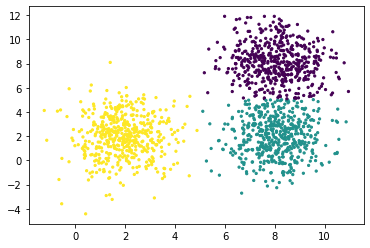

In [0]:
import numpy as np
from sklearn.cluster import KMeans

means = [[2, 2], [8, 8], [8, 2]]
cov = [[1, 0], [0, 3]]
N = 500
X0 = np.random.multivariate_normal(means[0], cov, N)
X1 = np.random.multivariate_normal(means[1], cov, N)
X2 = np.random.multivariate_normal(means[2], cov, N)

X = np.concatenate((X0, X1, X2), axis = 0)
K = 3

kmeans = KMeans(n_clusters=K, random_state=0).fit(X)

# print(kmeans.cluster_centers_)
pred_label = kmeans.predict(X)

# print(X.shape)
print(pred_label[1])

# print(X[:,1])

# plt.plot(X[:,0], X_1[:,1], linewidth=3, color='red')

def get_color(x):
  if x == 0:
    return 'blue'
  elif x == 1:
    return 'red'
  elif x == 2:
    return 'green'
  elif x == 3:
    return 'yellow'
  elif x == 4:
    return 'grey'
  elif x == 5:
    return 'pink'
  else: return 'black'


plt.scatter(X[:,0], X[:,1], s=5, c=pred_label)
# plt.scatter(X[:,0], X[:,1], s=5, c=get_color(1))
# i=0
# for x in X:
#   plt.scatter(x[0], x[1], s=5, c=get_color(pred_label[i]))
#   i=i+1



plt.show()

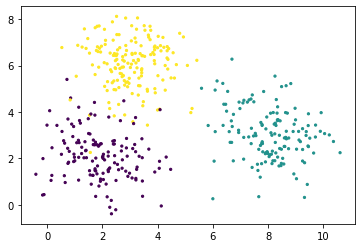

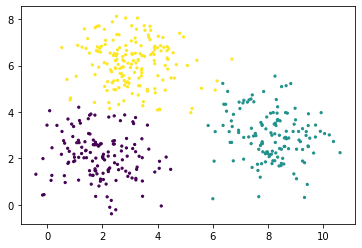

In [0]:
means = [[2, 2], [8, 3], [3, 6]]
cov = [[1, 0], [0, 1]]

N = 750
C = 3

X_0 = np.random.multivariate_normal(means[0], cov, N)
X_1 = np.random.multivariate_normal(means[1], cov, N)
X_2 = np.random.multivariate_normal(means[2], cov, N)
X = np.concatenate((X_0, X_1, X_2), axis = 0).T


# extended data: append a colum of number 1 to the left
X = np.concatenate((np.ones((1, C*N)), X), axis = 0).T
y = np.array([[0]*N,[1]*N,[2]*N]).reshape(C*N,)

# split train set and test set from data set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20)

# print(X_test[:,2])

plt.scatter(X_test[:,1], X_test[:,2], s=5, c=y_test)


plt.show()


from sklearn import linear_model
from sklearn.metrics import accuracy_score

# For a multi_class problem, if multi_class is set to 
# be “multinomial” the softmax function is used to 
# find the predicted probability of each class
logreg = linear_model.LogisticRegression(C=1e5, 
        solver = 'lbfgs', multi_class = 'multinomial')

# train
logreg.fit(X_train, y_train)

# test
y_pred = logreg.predict(X_test)

plt.scatter(X_test[:,1], X_test[:,2], s=5, c=y_pred)


plt.show()

In [0]:
import numpy as np
from matplotlib import pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split

# Generate 'random' data
N = 1000
np.random.seed(0)

X = (2.5 * np.random.randn(N) + 1.5)   # Array of N values with mean = 1.5, stddev = 2.5
res = 0.5 * np.random.randn(N)       # Generate N residual terms
y = 2 + 0.3 * X + res                  # Actual values of Y

X = X.reshape(N, 1)

# Split data and label into 2 sets: train set, test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20)

In [0]:
reg = LinearRegression().fit(X_train, y_train)

# reg.score(X_test, y_test)
coef = reg.coef_
intercept = reg.intercept_

y_pred = reg.predict(X_test)

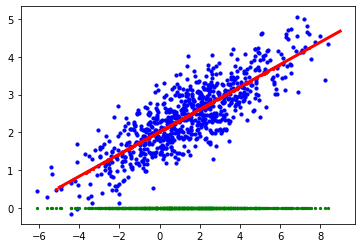

In [0]:
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

X_train_array = X_train[:,0]

x=10
x1=[0,x]

y=coef[0]*x+ intercept
y1=[y,4.969]

h= np.linspace(-5,9,300)
v= h *coef[0] + intercept

plt.scatter(X_train_array, y_train, s=10, c='blue')
plt.scatter(X_train_array,[0]*len(X_train_array),s=5,c='green')
plt.plot(h , v, linewidth=3, color='red')
plt.scatter(X_test,y_pred,s=5,c='red')
plt.show()

[0. 0.]
2
[[1. 2. 2.]
 [1. 3. 3.]]
13
[0. 0.]


In [0]:
import numpy as np
import matplotlib.pyplot as plt

In [0]:

def sign(x):
  # x is a scalar (number)
  # TODO: implement sign function. Sign function
  #       returns 1  if x is positive, 
  #       returns -1 otherwise
  if x > 0 :
    return 1
  else: 
    return -1

def generate_X_dot(X):
  # X is a matrix size n*f, where:
  #   n is the number of sample x in X
  #   f is the number of features of a single sample x
  # TODO: Append a column of number 1 to the left of X
  # axis: 0 hang
  # axis: 1 cot

  # T: chuyen vi
  # np.ones(hang, cot)): 
  ones = np.concatenate((np.ones((len(X),1),dtype=float),X), axis = 1)
  return ones


def predict_single_data(x_dot, w_dot):
  # x_dot is an array contains f+1 element, where
  #       f is the number of feature of x
  # w_dot is a column vector that has the same size with x_dot
  # TODO: implement function to predict label of x_dot
  return sign(np.dot(x_dot,w_dot))

def predict(X_dot, w_dot):
  # X_dot is a matrix size n*(f+1), where:
  #       n is the number of sample x_dot in X_dot
  #       f is the number of feature of x in X
  # TODO: calculate y from data X_dot and weight w_dot
  rs = []
  for x_dot in X_dot:
    rs.append(predict_single_data(x_dot,w_dot))

  return np.array(rs)

def update_w_dot(x_dot, w_dot, y, learning_rate):
  # x_dot is an array contains f+1 element, where
  #       f is the number of feature of x
  # w_dot is a column vector that has the same size with x_dot
  # y     is the corresponding label of current x_dot
  # learning_rate is a float
  # TODO: implement function to update w_dot
  return w_dot + x_dot*y*learning_rate

def train(X, y, epochs, learning_rate):
  # X      is a matrix size n*f, where:
  #        n is total sample x in X
  #        f is the number of feature of x in X
  # y      is an array of known labels corresponding
  #        to each sample x in X
  # epochs is total training loops over data set
  # learning_rate is eta in formal equation (lecture note)
  # TODO: generate X_dot from X
  
  w_dot = np.zeros(len(X[0])+1)
  X_dot = generate_X_dot(X)



  for epoch in range(epochs):
    # TODO:
    # - predict label of every point x_dot in X_dot
    # - if this point is missclassified, update w_dot
    for i in range(len(X_dot)):
      if predict_single_data(X_dot[i],w_dot) != y[i]:
        w_dot = update_w_dot(X_dot[i],w_dot,y[i],learning_rate)

  return w_dot
def train_verbose(X, y, epochs, learning_rate):
  
  # TODO: generate X_dot from X
  
  w_dot = np.zeros(len(X[0])+1)

  X_dot = generate_X_dot(X)

  error_history = []

  for epoch in range(epochs):
    # TODO:
    # - predict label of every point x_dot_i
    # - if this point is missclassified, update w_dot
    # - remember to append total missclassified points 
    #   to error_history in every epoch
    num_of_error = 0
    for i in range(len(X_dot)):
      if predict_single_data(X_dot[i],w_dot) != y[i]:
        w_dot = update_w_dot(X_dot[i],w_dot,y[i],learning_rate)
        num_of_error += 1
    error_history.append(num_of_error)
  return w_dot, error_history

In [0]:
X = np.array([[2,5],[3,4],[2,7]])
X_dot = generate_X_dot(X)
w = np.zeros(len(X[0]) + 1)

test = predict_single_data(X_dot[1],w)
Z = predict(X_dot,w)

update = update_w_dot(X_dot[1],w, Z,0.2)

# print(X)
# print(X_dot)
print('w',w)
print(test)
print(Z)

print(update)

w [0. 0. 0.]
-1
[-1 -1 -1]
[-0.2 -0.6 -0.8]


In [0]:
# Generate data set
import numpy as np
from sklearn.model_selection import train_test_split

N = None
means = [[2, 2], [4, 4]]
cov = [[1, 0], [0, 1]]

N = 500
C = 2

X_0 = np.random.multivariate_normal(means[0], cov, N)
X_1 = np.random.multivariate_normal(means[1], cov, N)

X = np.concatenate((X_0, X_1), axis = 0)
y = np.array([[-1]*N,[1]*N]).reshape(C*N,)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20)

In [0]:
# w_dot = train(X_train, y_train, learning_rate=0.1, epochs = 20)
epochs = 20
w_dot, error_history = train_verbose(X_train, y_train, epochs = 20, learning_rate=0.1)

print(w_dot)
print(error_history)
# TODO: calculate y_pred based on learned w_dot
X_test_dot = generate_X_dot(X_test)
y_pred = predict(X_test_dot,w_dot)
# print(w_dot.shape)
# print(X_test.shape)
from sklearn.metrics import accuracy_score
print("Accuracy: %.2f %%" %(100*accuracy_score(y_test, y_pred)))

[-7.1         0.95097106  0.94773124]
[178, 114, 119, 107, 110, 98, 100, 100, 91, 89, 101, 97, 90, 95, 97, 86, 97, 97, 101, 92]
Accuracy: 85.50 %


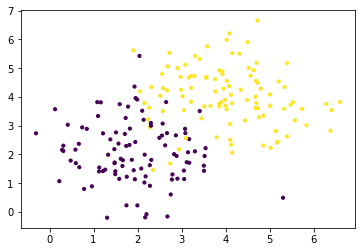

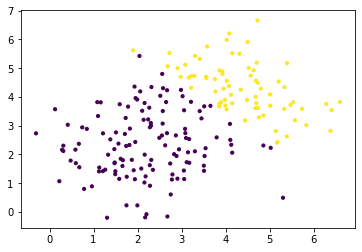

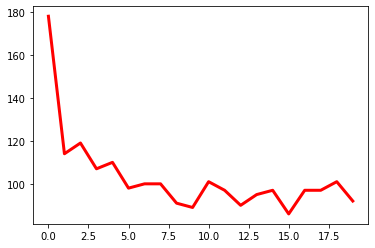

In [0]:
import matplotlib.pyplot as plt

# print (X_test[0])

plt.scatter(X_test[:,0], X_test[:,1], s=10, c=y_test)


plt.show()

plt.scatter(X_test[:,0], X_test[:,1], s=10, c=y_pred)

plt.show()

# print(error_history[0])

# h= np.linspace(0,5,epochs, True)
# v= h *error_history[0] + w_dot[0]

# print(h)

epochs_arr = range(len(error_history))

# plt.plot(h, v, linewidth=3, color='red')
# plt.show()

plt.plot(epochs_arr,error_history,linewidth=3, color='red')

plt.show()


In [0]:
import numpy as np

x = np.ones((1,11))

print(x)

[[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]]
